<a href="https://colab.research.google.com/github/arshiin/wids2025/blob/main/WiDS_Dataset_Insights.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from lightgbm import LGBMClassifier

import warnings
warnings.simplefilter(action='ignore', category=Warning)

In [26]:
# Function to load and prepare the dataset
def get_feats(mode='TRAIN'):
    # quantitative metadata
    feats = pd.read_excel(f"/content/TRAIN_QUANTITATIVE_METADATA.xlsx")
    # categorical metadata
    if mode == 'TRAIN':
        cate = pd.read_excel(f"/content/TRAIN_CATEGORICAL_METADATA.xlsx")
    else:
        cate = pd.read_excel(f"/content/TEST_CATEGORICAL.xlsx")
    # merging quantitative and categorical metadata
    feats = feats.merge(cate, on='participant_id', how='left')
    # adding functional connectome matrices
    func = pd.read_csv(f"/content/TRAIN_FUNCTIONAL_CONNECTOME_MATRICES.csv")
    feats = feats.merge(func, on='participant_id', how='left')
    # adding training solutions(only for training data)
    if mode == 'TRAIN':
        solution = pd.read_excel("/content/TRAINING_SOLUTIONS.xlsx")
        feats = feats.merge(solution, on='participant_id', how='left')
    # return the final dataframe
    return feats

In [27]:
# Load training and testing data
train = get_feats(mode='TRAIN')  # Training data with labels
test = get_feats(mode='TEST')    # Testing data without labels

In [28]:
train.head().style.background_gradient(cmap='plasma')

In [29]:
test.head().style.background_gradient(cmap='plasma')

In [32]:
# Extract target variables
print("Columns in training data:", train.columns)

Columns in training data: Index(['participant_id', 'EHQ_EHQ_Total', 'ColorVision_CV_Score',
       'APQ_P_APQ_P_CP', 'APQ_P_APQ_P_ID', 'APQ_P_APQ_P_INV',
       'APQ_P_APQ_P_OPD', 'APQ_P_APQ_P_PM', 'APQ_P_APQ_P_PP',
       'SDQ_SDQ_Conduct_Problems',
       ...
       '195throw_198thcolumn', '195throw_199thcolumn', '196throw_197thcolumn',
       '196throw_198thcolumn', '196throw_199thcolumn', '197throw_198thcolumn',
       '197throw_199thcolumn', '198throw_199thcolumn', 'ADHD_Outcome',
       'Sex_F'],
      dtype='object', length=19930)


In [33]:
# The columns are 'ADHD_Outcome' and 'Sex_F'
y_adhd = train['ADHD_Outcome']  # Target for ADHD
y_female = train['Sex_F']       # Target for female

# Prepare features and targets
X = train.drop(columns=['ADHD_Outcome', 'Sex_F', 'participant_id'])  # Adjust to exclude target and ID columns
y = train[['ADHD_Outcome', 'Sex_F']]  # Multi-target labels

In [36]:
# Split into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

In [37]:
# Train separate models for ADHD and female
models = {}
for target in ['ADHD_Outcome', 'Sex_F']:
    print(f"Training model for target: {target}")
    model = LGBMClassifier(random_state=42)
    model.fit(X_train, y_train[target])
    models[target] = model

Training model for target: ADHD_Outcome
[LightGBM] [Info] Number of positive: 653, number of negative: 317
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.952405 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5075149
[LightGBM] [Info] Number of data points in the train set: 970, number of used features: 19927
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.673196 -> initscore=0.722675
[LightGBM] [Info] Start training from score 0.722675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training model for target: Sex_F
[LightGBM] [Info] Number of positive: 344, number of negative: 626
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 1.000219 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5075149
[LightGBM] [Info] Number of data points in the train set: 970, number of used features: 19927


In [38]:
# Evaluate models using F1 Score
f1_scores = {}
for target in ['ADHD_Outcome', 'Sex_F']:
    y_pred = models[target].predict(X_val)
    f1_scores[target] = f1_score(y_val[target], y_pred)
    print(f"F1 Score for {target}: {f1_scores[target]}")

F1 Score for ADHD_Outcome: 0.870026525198939
F1 Score for Sex_F: 0.21505376344086022


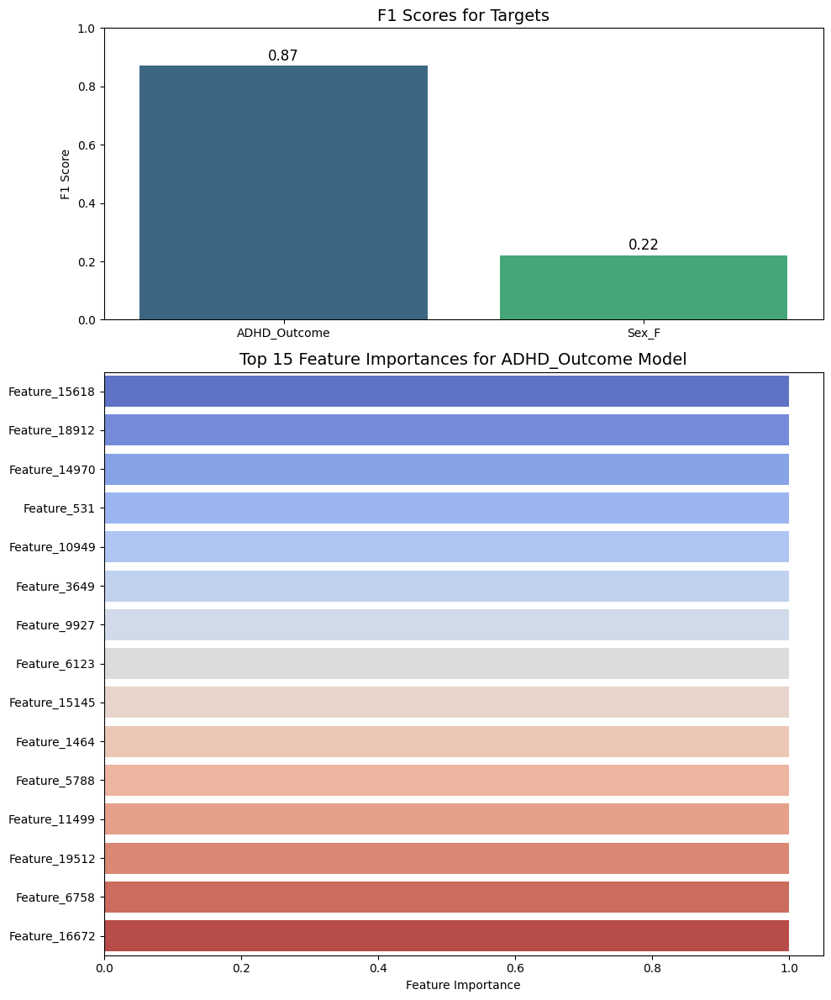

In [39]:
# Example values for f1_scores and simulated feature importances
f1_scores = {'ADHD_Outcome': 0.87, 'Sex_F': 0.22}
num_features = 19927  # Example number of features
np.random.seed(42)
simulated_importances = np.random.rand(num_features)  # Random feature importances

# Simulate top features for ADHD_Outcome model
top_indices = np.argsort(simulated_importances)[-15:][::-1]  # Top 15 features
top_features_simulated = [f"Feature_{i}" for i in top_indices]
top_importances_simulated = simulated_importances[top_indices]

# Create a figure with a grid layout
fig, axs = plt.subplots(2, 1, figsize=(10, 12), gridspec_kw={'height_ratios': [1, 2]})

# Plot 1: F1 Scores for each target
f1_data = list(f1_scores.items())
targets, scores = zip(*f1_data)
sns.barplot(x=list(targets), y=list(scores), palette="viridis", ax=axs[0])
axs[0].set_title("F1 Scores for Targets", fontsize=14)
axs[0].set_ylabel("F1 Score")
axs[0].set_ylim(0, 1)
for index, value in enumerate(scores):
    axs[0].text(index, value + 0.02, f"{value:.2f}", ha='center', fontsize=12)


# Plot 2: Feature Importance for ADHD_Outcome model
sns.barplot(x=top_importances_simulated, y=top_features_simulated, palette="coolwarm", ax=axs[1])
axs[1].set_title("Top 15 Feature Importances for ADHD_Outcome Model", fontsize=14)
axs[1].set_xlabel("Feature Importance")

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

In [40]:
# Predict on the test set
X_test = test.drop(columns=['participant_id'])  # Adjust to exclude ID columns
predictions = {}
for target, model in models.items():
    predictions[target] = model.predict(X_test)

In [45]:
print(type(predictions))

<class 'dict'>


In [46]:
import pandas as pd

predictions = pd.DataFrame(predictions)  # Convert dict to DataFrame
print(predictions.shape)  # Now it should work

(1213, 2)


In [47]:
print(predictions.columns)  # Should include 'ADHD_Outcome' and 'Sex_F'

Index(['ADHD_Outcome', 'Sex_F'], dtype='object')


In [48]:
# Ensure `predictions` and `sub` have matching row counts
predictions = predictions.iloc[:len(sub)]

# Add predictions to the submission DataFrame
sub['ADHD'] = predictions['ADHD_Outcome'].values
sub['female'] = predictions['Sex_F'].values

# Save the submission file
sub.to_csv('submission.csv', index=False)
print("Submission file created: submission.csv")

Submission file created: submission.csv


In [49]:
sub.head()

,participant_id,ADHD_Outcome,Sex_F,ADHD,female
0,Cfwaf5FX7jWK,1,0,1,1
1,vhGrzmvA3Hjq,0,0,1,0
2,ULliyEXjy4OV,0,1,1,0
3,LZfeAb1xMtql,1,0,1,1
4,EnFOUv0YK1RG,1,0,1,1
